# Building a "large-scale" image search engine

<img src="https://i.imgur.com/rPUaOgO.png" width="600"/>

You and your team are surely on the path to fame and fortune! You have been recruited by Google to disrupt Google Image Search by building a better search engine using novel statistical learning techniques.

The specifications are simple: We need a way to search for relevant images given a natural language query. For instance, if a user types "dog jumping to catch frisbee", your system will rank-order the most relevant images from a large database.

In this tutorial, we provide you with some tools to get you started with this task. We will first do some data exploration and then we will step through the benchmark approach that you have to beat (see [Kaggle](https://www.kaggle.com/c/cs5785-fall-2021-final)). Finally, we will give examples of possible further directions.

**Warning/ Disclaimer:** Proceed with caution. There might be mistakes in this notebook, it is up to you to check every step if you are using these code snippets in your pipeline.

### Summary

* [Data Exploration](#Data-Exploration)
    * [Images](#Images)
    * [Tags](#Tags)
    * [ResNet Feature Vectors](#ResNet-Feature-Vectors)
    * [Descriptions](#Descriptions)
* [Baseline Approach](#Baseline-Approach)
    * [Featurize descriptions](#Featurize-descriptions)
    * [Subsample ResNet features](#Subsample-ResNet-features)
    * [Train and Test](#Train-and-Test)
    * [Submit](#Submit)
* [Further Directions](#Further-Directions)

# Data Exploration

In [1]:
# Some imports
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from PIL import Image
from matplotlib.pyplot import figure

%matplotlib inline

# you might have to tweak the data directory depending on where you downloaded the data
# DATA_DIR = "./cs5785-fall-2021-final"

In [2]:
image1 = 2000
image2 = 4567

## Images

Each image has been resized to 224px by 224px.

In [3]:
def show_image(image_index, train_set=True):
    """Display image with given index.
    
    Parameters
    ----------
    image_index: int
        Numeric index of the image (max 9999 for train, max 1999 for test).
    train_set: bool (default=True)
        Whether to look in the train or in the test set.
    """
    if train_set:
        dataset = 'train'
    else:
        dataset = 'test'
    image = Image.open(os.path.join(f'images_{dataset}/{image_index}.jpg'))
    plt.imshow(image)
    plt.show()

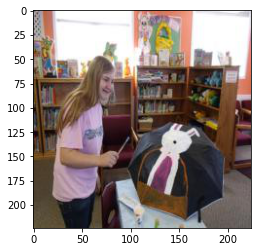

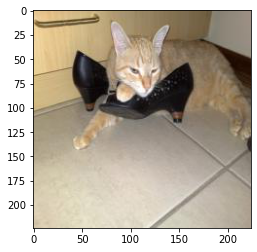

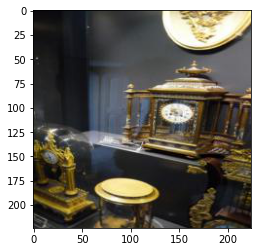

(None, None, None)

In [4]:
show_image(image1), show_image(image2), show_image(205)

## Tags

Each image has associated tags provided by a human.

In [5]:
def get_tags(image_index, train_set=True):
    """Get tags of image with given index.
    
    Parameters
    ----------
    image_index: int
        Numeric index of the image (max 9999 for train, max 1999 for test).
    train_set: bool (default=True)
        Whether to look in the train or in the test set.
        
    Returns
    -------
    tags: list of string
        List of tags associated with each image.
    """
    if train_set:
        dataset = 'train'
    else:
        dataset = 'test'
    f = open(
        os.path.join(f'tags_{dataset}/{image_index}.txt'))
    tags = f.readlines()
    f.close()
    # Some post processing
    tags = [t.strip("\n.") for t in tags]
    return tags

In [6]:
get_tags(207)

['person:person', 'outdoor:bench', 'sports:skateboard', 'vehicle:car']

In [7]:
def get_tags_split(image_index, train_set=True):
    """get tag categories and tagwords of image"""
    tags = get_tags(image_index, train_set)
    tag_categories = []
    tag_words = []
    for tag in tags:
        split_tag = tag.split(":")
        tag_categories.append(split_tag[0])
        tag_words.append(split_tag[1])
    return tag_categories, tag_words

# testing
get_tags_split(207)

(['person', 'outdoor', 'sports', 'vehicle'],
 ['person', 'bench', 'skateboard', 'car'])

In [8]:
def get_all_tag_categories():
    """
    returns list of all possible tag categories (i.e. everything before the : for all tags)"""
    categories=[]
    for idx in range(10000): # training set
        tag_categories, _ = get_tags_split(idx)
        for cat in tag_categories:
            if not cat in categories:
                categories.append(cat)
    for idx in range(2000): # test set
        tag_categories, _ = get_tags_split(idx, train_set=False)
        for cat in tag_categories:
            if not cat in categories:
                categories.append(cat)
    return sorted(categories)

# see categories
all_tag_categories = get_all_tag_categories()
all_tag_categories

['accessory',
 'animal',
 'appliance',
 'electronic',
 'food',
 'furniture',
 'indoor',
 'kitchen',
 'outdoor',
 'person',
 'sports',
 'vehicle']

## ResNet Feature Vectors

Each image has 1000 features provided extracted from the penultimate layer of the pretrained ResNet neural network.

Importing word2vec

In [9]:
import gensim
word2vec = gensim.models.KeyedVectors.load_word2vec_format("GoogleNews-vectors-negative300.bin.gz", binary=True)
print("Loaded word vectors successfully!")

Loaded word vectors successfully!


In [10]:
# Example usage of featurizing descriptions
word2vec.get_vector("carrot").shape

(300,)

In [11]:
def featurize_tags(image_index, train_set=True):
    """for image_index, return featurized version of the tag for that image"""
    vector = np.array([])
    image_tag_categories, image_tag_words = get_tags_split(image_index, train_set)
    for tag_category in all_tag_categories:
        if tag_category in image_tag_categories:
            idx = image_tag_categories.index(tag_category)
            # if image tag word has more than one word, just take the first word out of the phrase
            word = image_tag_words[idx] if " " not in image_tag_words[idx] else image_tag_words[idx].split(" ")[0]
            vectorized_word = word2vec.get_vector(word)
        else:
            vectorized_word= np.zeros(300) #no tag for this word
        vector= np.append(vector, vectorized_word)
    return vector
            
    

def get_feat_matrix(train_set=True):
    """Get feature matrix for given dataset
    
    Parameters
    ----------
    train_set: bool (default=True)
        Whether to look in the train or in the test set.
        
    Returns
    -------
    X: ndarray of shape (n, 1000)
        A matrix containing the ResNet features for the train or test images.
    """
    if train_set:
        dataset = 'train'
    else:
        dataset = 'test'
    feats = pd.read_csv(
        os.path.join(f'features_{dataset}/features_resnet1000_{dataset}.csv'),
        names = ['Image']+["X{}".format(i) for i in range(1000)])
    # Need to sort data
    feats["Image"] = feats["Image"].apply(lambda s: int(s.split("/")[1].split(".jpg")[0]))
    feats.sort_values(by="Image", inplace=True)
    X = feats.values[:, 1:]
    
    
    
    # add tag data
    tag_data_matrix = np.zeros((10000 if train_set else 2000,300*len(all_tag_categories)))
    for row_num in range(tag_data_matrix.shape[0]):
        featurized_tags = featurize_tags(row_num, train_set)
        tag_data_matrix[row_num]=featurized_tags
    X = np.concatenate((X,tag_data_matrix),axis=1)
    return X

In [12]:
X_train = get_feat_matrix()
X_train.shape

(10000, 4600)

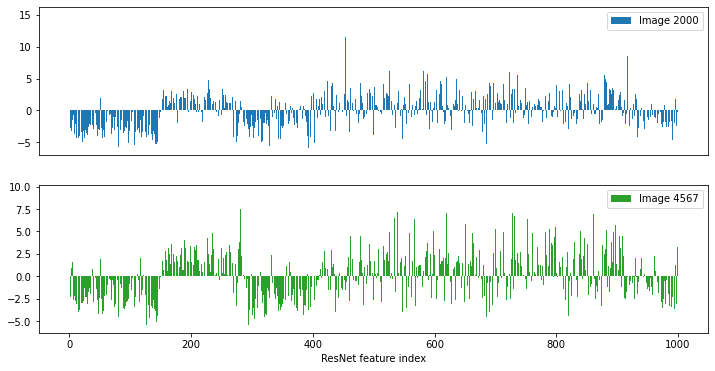

In [13]:
fig, (ax1, ax2) = plt.subplots(2, figsize=(12,6))
ax1.bar(np.arange(1000), X_train[image1,:1000], label=f"Image {image1}")
ax1.set_xticks([])
ax1.legend()
ax2.bar(np.arange(1000), X_train[image2,:1000], label=f"Image {image2}", color='C2')
ax2.legend()
ax2.set_xlabel("ResNet feature index")
plt.show()

## Descriptions 

Each image comes with a series of human given queries (descriptions).

In [14]:
import re
import nltk
nltk.download('stopwords')
nltk.download('averaged_perceptron_tagger')
nltk.download('wordnet')
from nltk.tokenize import WordPunctTokenizer
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer

def postprocess_text(text):
    """
    postprocessing for description obtained by get_description function
    - lowercase everything
    - removed non-words (e.g. numbers, symbols)
    - removed tokens that contain < 2 letters
    - removed tokens that contained only consonants
    - removed stopwords (e.g. prepositions) based on nltk stopwords list
    - lemmatizing
    
    reference: https://towardsdatascience.com/text-processing-in-python-29e86ea4114c
    """
    # Using tokenizer to separate the sentences into a list of single words
    word_punct_token = WordPunctTokenizer().tokenize(text) 
    
    # lowercase, removing non-words, tokens that contain < 2 letters, or contain only consonants
    clean_token=[]
    for token in word_punct_token:
        token = token.lower()
        # remove any value that are not alphabetical
        new_token = re.sub(r'[^a-zA-Z]+', '', token) 
        # remove empty value and single character value
        if new_token != "" and len(new_token) >= 2: 
            vowels=len([v for v in new_token if v in "aeiou"])
            if vowels != 0: # remove line that only contains consonants
                clean_token.append(new_token)
                
    # remove stopwords
    stop_words = stopwords.words('english')     # Get the list of stop words
    # add new stopwords to the list
    stop_words.extend(["could","though","would","also","many",'much'])
#     print(stop_words)
    # Remove the stopwords from the list of tokens
    tokens = [x for x in clean_token if x not in stop_words]
    
    # part of speech tagging
    data_tagset = nltk.pos_tag(tokens)
    df_tagset = pd.DataFrame(data_tagset, columns=['Word', 'Tag']) # put (word, tag) tuples into df
    
    # lemmatizing
    lemmatizer = WordNetLemmatizer() # Create lemmatizer object 
    # Lemmatize each word and display the output
    lemmatize_text = []
    for word in tokens:
        # lemmatize based on all POS to improve accuracy of lemmatizer
        output = [word, lemmatizer.lemmatize(word, pos='n'),
                  lemmatizer.lemmatize(word, pos='a'),
                  lemmatizer.lemmatize(word, pos='v')]
        lemmatize_text.append(output)
    # create DataFrame using original words and their lemma words
    df = pd.DataFrame(lemmatize_text, columns =['Word', 'Lemmatized Noun', 'Lemmatized Adjective', 'Lemmatized Verb']) 
    df['Tag'] = df_tagset['Tag']
    
    # assign the correct lemmatized word to the original word according to their POS Tag
    # replace with single character for simplifying
    df = df.replace(['NN','NNS','NNP','NNPS'],'n')
    df = df.replace(['JJ','JJR','JJS'],'a')
    df = df.replace(['VBG','VBP','VB','VBD','VBN','VBZ'],'v')
    
    # take the correct lemmatized word based on word's tagged POS
    df_lemmatized = df.copy()
    df_lemmatized['Tempt Lemmatized Word']=df_lemmatized['Lemmatized Noun'] + ' | ' + df_lemmatized['Lemmatized Adjective']+ ' | ' + df_lemmatized['Lemmatized Verb']
    lemma_word = df_lemmatized['Tempt Lemmatized Word']
    tag = df_lemmatized['Tag']
    i = 0
    new_word = []
    while i<len(tag):
        words = lemma_word[i].split('|')
        if tag[i] == 'n':
            word = words[0]
        elif tag[i] == 'a':
            word = words[1]
        elif tag[i] == 'v':
            word = words[2]
        new_word.append(word)
        i += 1
    df_lemmatized['Lemmatized Word']=new_word
    
    # obtain cleaned tokens as list
    lemma_word = [str(x) for x in df_lemmatized['Lemmatized Word']]
    lemma_word = [re.sub(' +', ' ', x) for x in lemma_word]
    lemma_word = [x.strip() for x in lemma_word]
#     lemma_word = list(set(lemma_word)) # remove duplicates
    
    # convert list to str
    text = " ".join(lemma_word)
    
    return text

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/ibt2user/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /Users/ibt2user/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/ibt2user/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [15]:
def get_description(image_index, train_set=True):
    """Get description of image with given index.
    
    Parameters
    ----------
    image_index: int
        Numeric index of the image (max 9999 for train, max 1999 for test).
    train_set: bool (default=True)
        Whether to look in the train or in the test set.
        
    Returns
    -------
    description: string
        The description of the image as a paragraph of text with punctuation removed.
    """
    if train_set:
        dataset = 'train'
    else:
        dataset = 'test'
    f = open(
        os.path.join(f'descriptions_{dataset}/{image_index}.txt'))
    desc = f.read()
    f.close()
    # Some post-processing 
    desc = postprocess_text(desc)
    
    
    return desc

In [16]:
get_description(208)

'snowboarder fall skinny tree person snowboard wipe snow person accident rid rid skier take bad fall fall leg air person rid snow board fall fall side'

**The Task:** Map descriptions to images (featurized by tags and ResNet features). 

# Baseline approach

This baseline approach combines a language model with the ResNet vision model to map descriptions to images via regression. These are the steps:

1. Featurize the descriptions using the pre-trained [word2vec](https://www.tensorflow.org/tutorials/representation/word2vec) language model. This will serve as your model features $\textbf{X}$. 

2. Subsample the ResNet feature vectors down to 100 features. This will serve as your model target $\textbf{Y}$. 

3. Train a model (i.e. Ridge Regression) that maps $\textbf{X}\rightarrow \textbf{Y}$, i.e. the extracted description features to the subsampled ResNet  features.

4. Use the trained model to find the predicted subsampled ResNet vector. Then find the 20 images in the test set for which the subsampled ResNet vectors are closest to the predicted vector in Euclidian distance. 

In [17]:
# uncomment this when you run for the first time

# # Some preliminaries
# # Comment this out after you run it for the first time

# # Install packages
# !pip install gensim
# import gensim

# # Download files
# import urllib.request
# import os
# # You can change the path to the downloaded file here
# if not os.path.exists("GoogleNews-vectors-negative300.bin.gz"):
#     urllib.request.urlretrieve("https://s3.amazonaws.com/dl4j-distribution/GoogleNews-vectors-negative300.bin.gz", filename="GoogleNews-vectors-negative300.bin.gz")

## Featurize descriptions

Recall, these will become your features $\textbf{X}$.

In order to featurize the descriptions, we use <a href="https://www.tensorflow.org/tutorials/representation/word2vec">word2vec</a>, which provides a pre-trained 300-dimensional vector representation of most words in the English language. 

We downloaded the word vectors in a file called `GoogleNews-vectors-negative300.bin.gz` from the above link and we will use the <a href="https://radimrehurek.com/gensim/">gensim</a> library in order to access the vectors easily in our code. The feature vector for a given description was then formed by averaging the 300-dimensional word2vec vectors of all the words in the description.

In [18]:
train_desc = [get_description(i) for i in range(10000)]
test_desc = [get_description(i, train_set=False) for i in range(2000)]

In [19]:
# def remove_single_occurrence_words(sentence):
#     """Remove words in sentence that occur only once"""
#     words_lst = sentence.split()
#     new_words_lst=[i for i in words_lst if words_lst.count(i)>1]
#     new_sentence = " ".join(new_words_lst)
#     return new_sentence
    

# def add_recurring_words(sentence,n):
#     """For all words that appear more than once, add each n times to the sentence"""
#     recurring_words=remove_single_occurrence_words(sentence)
#     recurring_words_lst = recurring_words.split()
#     # remove duplicates
#     new_lst = []
#     [new_lst.append(x) for x in recurring_words_lst if x not in new_lst]
#     new_sentence = sentence
#     for i in range(n):
#         new_sentence = new_sentence + " " + " ".join(new_lst)
#     return new_sentence
    
def doc_to_vec(sentence, word2vec):
    """Convert text to a 300-dimensional vector
    
    Each word is converted to a vector via the word-to-vec model and the vectors are averaged
    to give the final result.
    
    Parameters
    ----------
    sentence: string
        Text to be converted to a vector.
    word2vec: word2vec model
        Movel to be used for vectorization.
        
    Returns
    -------
    vec: array of shape (300, )
        Vector that represents the average of word2vec-transformed vectors for the given sentence. 
    """
#     word_vecs = [word2vec.get_vector(w.lower()) for w in sentence.split() if w.lower() in word2vec.key_to_index]
    
#     # Return average    
#     return np.stack(word_vecs).mean(0)
    
#     sentence = remove_single_occurrence_words(sentence) 
#     sentence = add_recurring_words(sentence,1)
    word_vecs = [word2vec.get_vector(w.lower()) for w in sentence.split() if w.lower() in word2vec.key_to_index]
    # Return average    
    return np.stack(word_vecs).mean(0)
    

In [20]:
# Example
doc_to_vec("I love this class!", word2vec)[:10]
doc_to_vec("I love this class!", word2vec).shape

(300,)

In [21]:
X = np.array([doc_to_vec(s, word2vec) for s in train_desc])
X_test = np.array([doc_to_vec(s, word2vec) for s in test_desc])

In [22]:
print("Shape of X:", X.shape)
print("Shape of X_test:", X_test.shape)
print("Done building features!")

Shape of X: (10000, 300)
Shape of X_test: (2000, 300)
Done building features!


## Subsample ResNet features

In order to form the target image vectors for each image we took the 1,000 ResNet and performed a random projection of these features down to 100 dimensions.

In [31]:
# Use PCA to reduce dimensions
from sklearn.decomposition import PCA
n_components = 500
pca = PCA(n_components = n_components)
pca.fit(get_feat_matrix())
Y = pca.transform(get_feat_matrix())
Y_test = pca.transform(get_feat_matrix(train_set=False))

In [32]:
# # Undo PCA
# Y = get_feat_matrix()
# Y_test = get_feat_matrix(train_set=False)

In [33]:
print("Shape of Y:", Y.shape)
print("Shape of Y_test:", Y_test.shape)
print("Done building features!")

Shape of Y: (10000, 500)
Shape of Y_test: (2000, 500)
Done building features!


## Train and Test

We train a regularized linear regression model that mapping a 300-dimensional description vector to the 100-dimensional image vector. We used Ridge with cross-validation to select the best regularization coefficient.

Our approach was validated on a held-out development set (randomly selected 20% subset of the training set) so **MAP@20** could be estimated before submitting to Kaggle. However the final model used to generate test predictions for submission was trained on the entire training set.

In [34]:
# Split training data for CV
from sklearn.model_selection import train_test_split
# X_train, X_val, Y_train, Y_val = train_test_split(X, Y, test_size=2000, random_state=12345)
X_train, X_val, Y_train, Y_val = train_test_split(X, Y, test_size=2000, random_state=2)
# X_train, X_val, Y_train, Y_val = train_test_split(X, Y, test_size=2000)

In [35]:
# from sklearn.preprocessing import MinMaxScaler


# scaler_x = MinMaxScaler()
# scaler_y = MinMaxScaler()
# scaler_x.fit(X)
# xtrain_scale=scaler_x.transform(X_train)
# xval_scale=scaler_x.transform(X_val)
# scaler_y.fit(Y)
# ytrain_scale=scaler_y.transform(Y_train)


In [36]:
# set up RF

from sklearn.ensemble import RandomForestRegressor

regr = RandomForestRegressor(n_estimators=75, max_depth=10, random_state=0,verbose=3)
regr.fit(X_train, Y_train)

building tree 1 of 75


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   19.8s remaining:    0.0s


building tree 2 of 75


[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   39.8s remaining:    0.0s


building tree 3 of 75
building tree 4 of 75
building tree 5 of 75
building tree 6 of 75
building tree 7 of 75
building tree 8 of 75
building tree 9 of 75
building tree 10 of 75
building tree 11 of 75
building tree 12 of 75
building tree 13 of 75
building tree 14 of 75
building tree 15 of 75
building tree 16 of 75
building tree 17 of 75
building tree 18 of 75
building tree 19 of 75
building tree 20 of 75
building tree 21 of 75
building tree 22 of 75
building tree 23 of 75
building tree 24 of 75
building tree 25 of 75
building tree 26 of 75
building tree 27 of 75
building tree 28 of 75
building tree 29 of 75
building tree 30 of 75
building tree 31 of 75
building tree 32 of 75
building tree 33 of 75
building tree 34 of 75
building tree 35 of 75
building tree 36 of 75
building tree 37 of 75
building tree 38 of 75
building tree 39 of 75
building tree 40 of 75
building tree 41 of 75
building tree 42 of 75
building tree 43 of 75
building tree 44 of 75
building tree 45 of 75
building tree 46 o

[Parallel(n_jobs=1)]: Done  75 out of  75 | elapsed: 24.8min finished


RandomForestRegressor(max_depth=10, n_estimators=75, random_state=0, verbose=3)

In [37]:
# Testing our model

# Map@20
def map_at_20(y_true, y_top_20):
    """Calculate the mean average precision at 20
    
    Parameters
    ----------
    y_true: list of object
        List of the true ID of the image.
        
    y_top_20: ndarray of shape (n, 20)
        List of top 20 IDs predicted for each image.
        
    Returns
    -------
    mean_score: float
        MAP@20 score.
    """
    y_true = np.array(y_true)
    y_top_20 = np.array(y_top_20)
    scores = []
    for i, y_true_i in enumerate(y_true):
        if y_true_i in y_top_20[i]:
            scores.append(1/(np.where(y_top_20[i]==y_true_i)[0][0]+1))
        else:
            scores.append(0)
    return np.mean(scores)
            
# Example
y_true = [1, 2]
y_top_20 = [
    [10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9],
    [20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39]
    ]
map_at_20(y_true, y_top_20)

0.041666666666666664

In [38]:
# for predicting with RF model

from sklearn.metrics.pairwise import cosine_distances

Y_val_pred = regr.predict(X_val)
pw_dist = cosine_distances(Y_val_pred, Y_val) 
print("Pairwise distances shape:", pw_dist.shape)
Y_val_top_20 = [np.argsort(pw_dist[i])[:20] for i in range(len(Y_val_pred))]
Y_val_true = np.arange(2000)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  75 out of  75 | elapsed:    0.3s finished


Pairwise distances shape: (2000, 2000)


In [39]:
val_score = map_at_20(Y_val_true, Y_val_top_20)
val_list_pos = [np.where(np.argsort(pw_dist[i])==i)[0][0] for i in range(len(Y_val_pred))]
print("Validation MAP@20:", val_score)
print("Mean index of true image:", np.mean(val_list_pos))
print("Median index of true image:", np.median(val_list_pos))

Validation MAP@20: 0.08318555749590967
Mean index of true image: 133.311
Median index of true image: 39.0


## Submit

We retrain the regression model on the entire dataset and generate test predictions for the Kaggle submission.

In [30]:
def get_Kaggle_submission(y_top_20):
    """Get data in Kaggle submission format
    
    Parameters
    ----------
    y_top_20: ndarray of shape (n, 20)
        A list of top 20 IDs lists that match each of the n descriptions. 
        
    Returns
    -------
    df: pandas.DataFrame
        Dataframe with columns and values that map correctly to Kaggle's expected submission format.
    """
    d = {
        "Description_ID": [f"{i}.txt" for i in range(len(y_top_20))],
        "Top_20_Image_IDs": [" ".join(
            [f"{j}.jpg" for j in y_top_20[i]]
        ) for i in range(len(y_top_20))]
    }
    return pd.DataFrame(d)

# Retrain on all data

# RF model
regr.fit(X, Y)
Y_test_pred = regr.predict(X_test)
pw_dist = cosine_distances(Y_test_pred, Y_test) 
Y_test_top_20 = [np.argsort(pw_dist[i])[:20] for i in range(len(Y_test_pred))]
df_submit = get_Kaggle_submission(Y_test_top_20)

# # regression model
# reg_best.fit(X, Y)
# Y_test_pred = reg_best.predict(X_test)
# pw_dist = dist.pairwise(Y_test_pred, Y_test)
# Y_test_top_20 = [np.argsort(pw_dist[i])[:20] for i in range(len(Y_test_pred))]
# df_submit = get_Kaggle_submission(Y_test_top_20)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


building tree 1 of 75


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:  1.2min remaining:    0.0s


building tree 2 of 75


[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:  2.4min remaining:    0.0s


building tree 3 of 75
building tree 4 of 75
building tree 5 of 75
building tree 6 of 75
building tree 7 of 75


KeyboardInterrupt: 

In [158]:
df_submit.head(10)

,Description_ID,Top_20_Image_IDs
0,0.txt,1011.jpg 124.jpg 1499.jpg 322.jpg 1883.jpg 998...
1,1.txt,331.jpg 833.jpg 1550.jpg 818.jpg 457.jpg 885.j...
2,2.txt,1183.jpg 634.jpg 838.jpg 953.jpg 1724.jpg 159....
3,3.txt,1765.jpg 1778.jpg 207.jpg 26.jpg 1514.jpg 750....
4,4.txt,1969.jpg 1011.jpg 1028.jpg 1298.jpg 1273.jpg 1...
5,5.txt,330.jpg 771.jpg 1335.jpg 630.jpg 1991.jpg 1292...
6,6.txt,718.jpg 1815.jpg 655.jpg 1216.jpg 16.jpg 217.j...
7,7.txt,448.jpg 987.jpg 1961.jpg 689.jpg 1285.jpg 1694...
8,8.txt,1283.jpg 1927.jpg 166.jpg 1567.jpg 1787.jpg 72...
9,9.txt,1700.jpg 1943.jpg 351.jpg 1355.jpg 321.jpg 142...


woman walk street past doorway woman walk past doorway sidewalk woman talk cell phone check watch woman talk cell phone check watch walk sidewalk woman wear blue phone walk walk sidewalk front building black planter side entrance



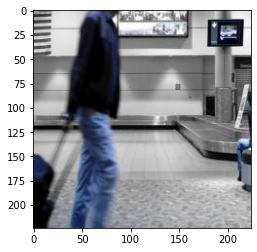

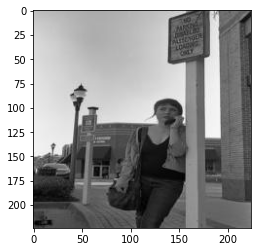

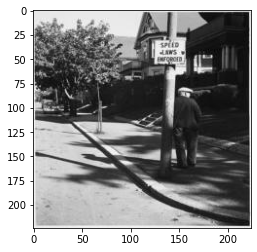

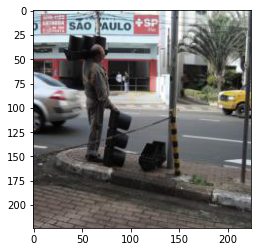

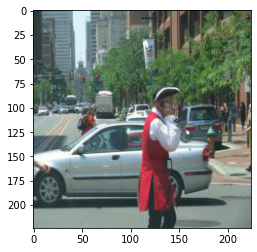

...

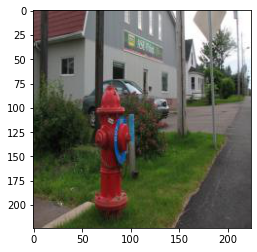

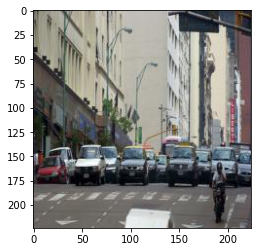

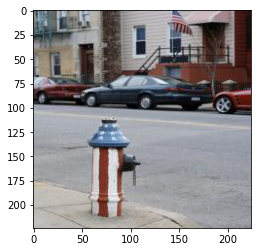

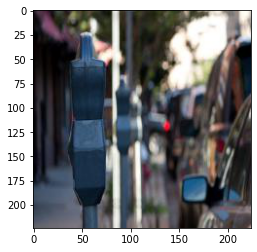

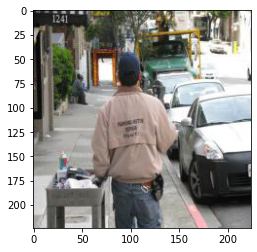

large slice angel food cake sit top plate small plate contains large slice cake quarter cake plate large piece yellow cake sits plate large slab sponge cake sits sits flowery plate



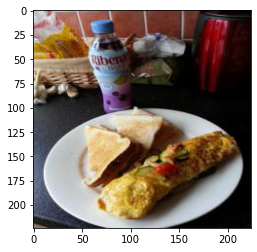

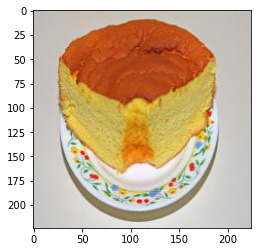

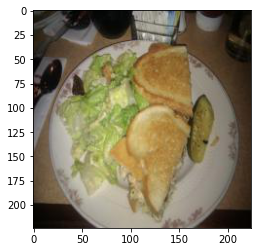

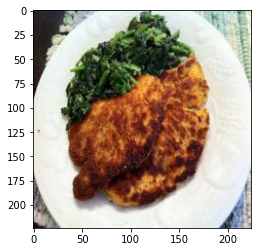

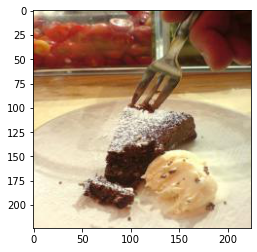

...

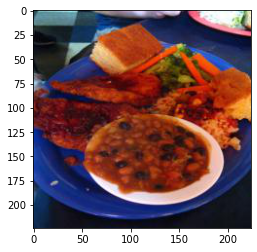

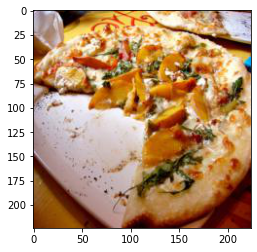

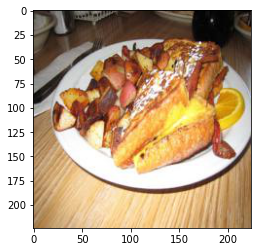

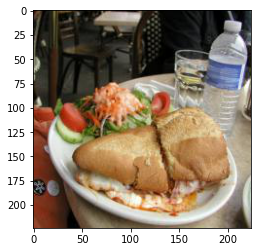

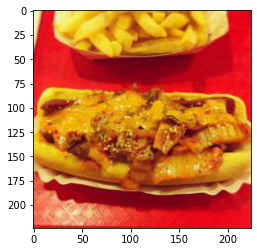

group traffic light sit intersection sign shin street light picture stoplight stoplight sun surround airplane traffic light several street light airplane fly overhead



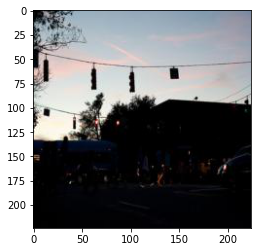

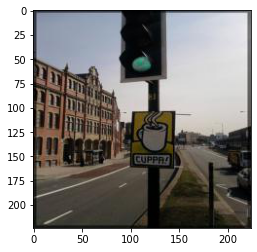

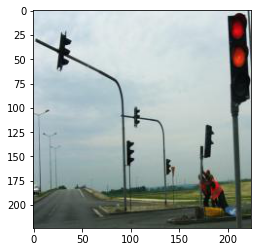

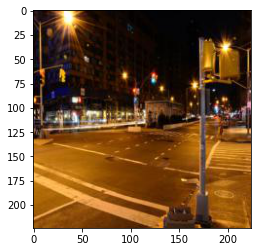

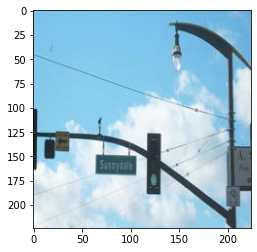

...

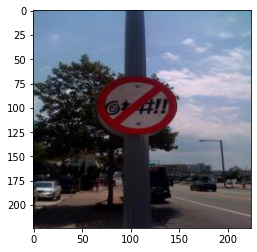

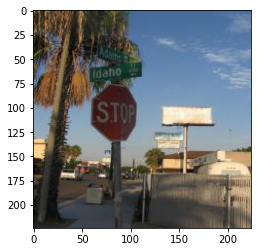

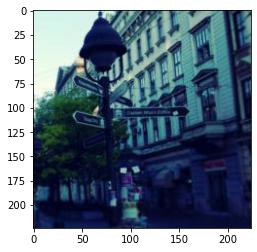

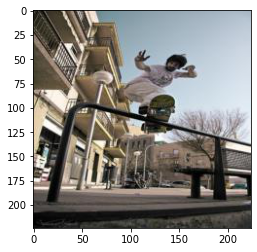

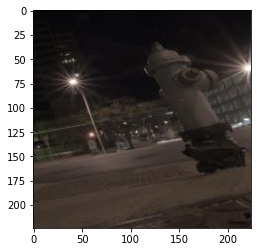

beach mean uniform riding horse side side sandy beach beach police officer horse rid beach beach people rid horse middle lot pair police officer ride horse beach beach people neon vest rid horse beach



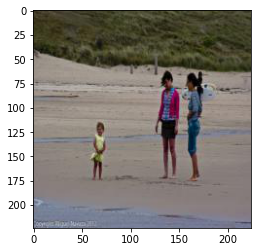

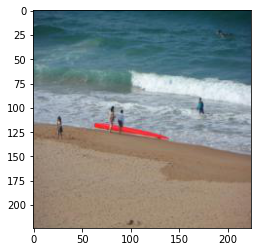

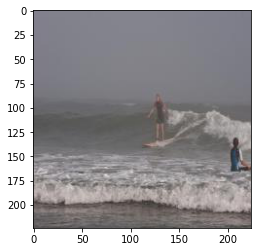

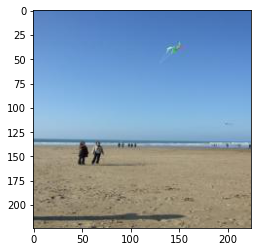

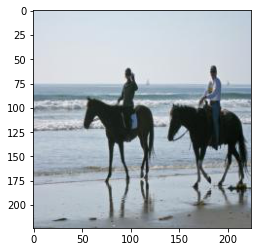

...

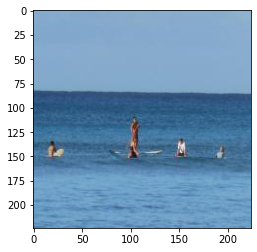

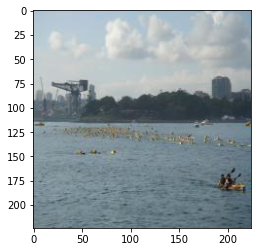

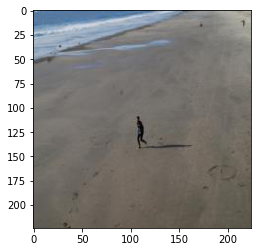

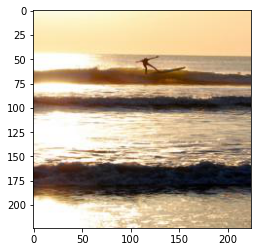

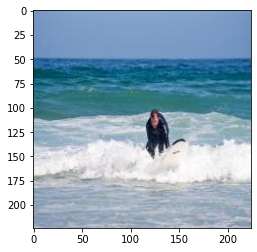

man woman use pay phone adjacent booth adult use pay telephone outdoors stand next soda machine couple people phone stand stand man woman talk public pay phone couple people talk phone



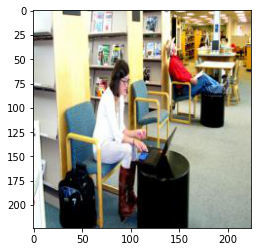

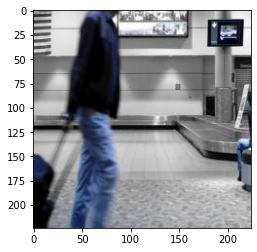

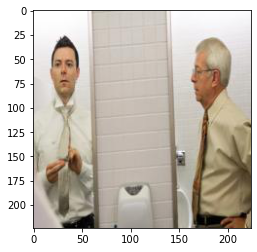

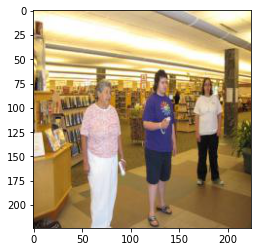

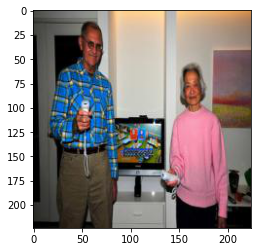

...

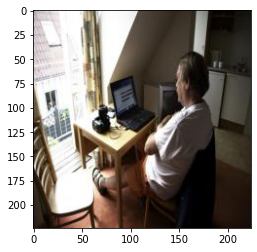

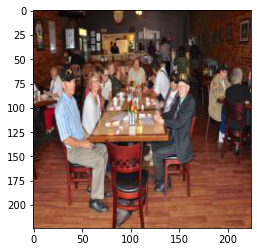

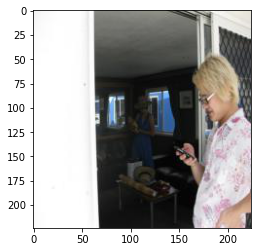

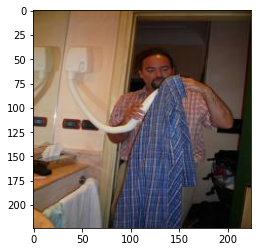

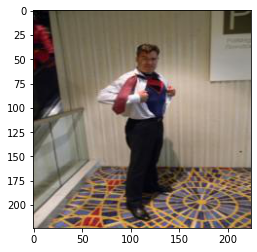

man trick skateboard skateboarder trick air wooden ramp blue cloud cloud person perform trick skateboard skateboarder jump ramp man jump skateboard park



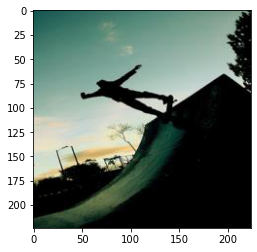

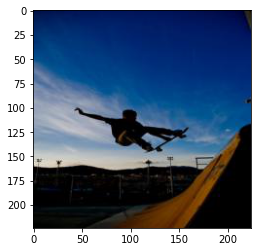

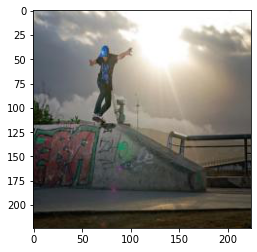

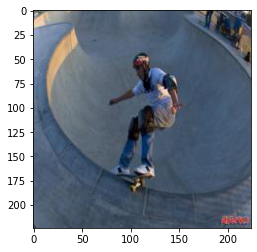

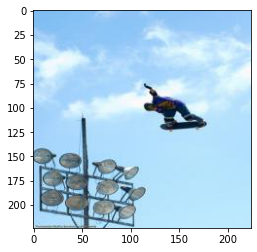

...

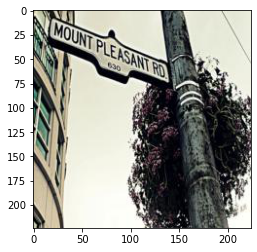

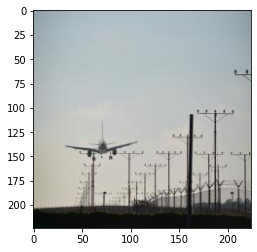

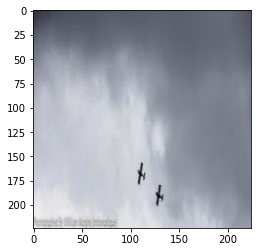

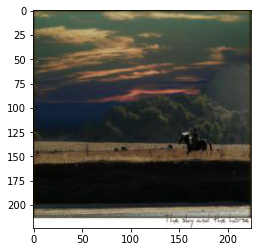

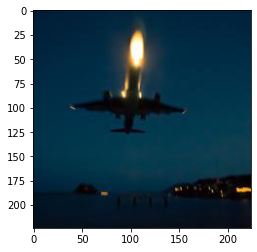

person ski air person jump air pair ski person get airborne ski slope skier trick air skier skier air slope



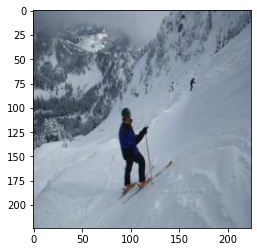

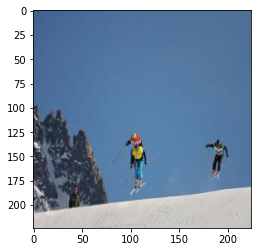

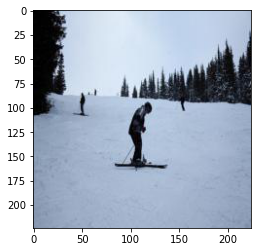

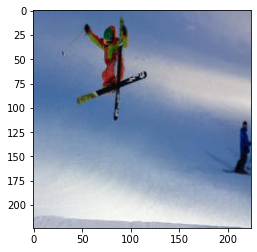

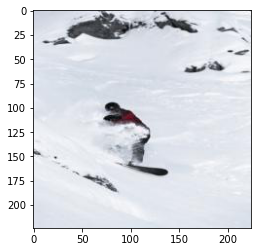

...

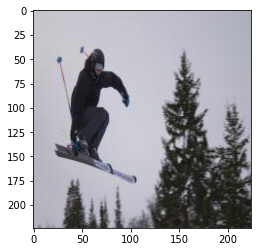

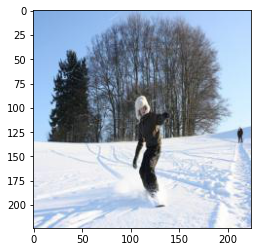

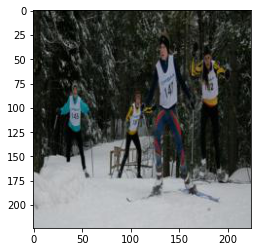

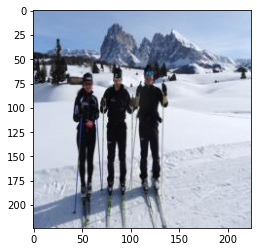

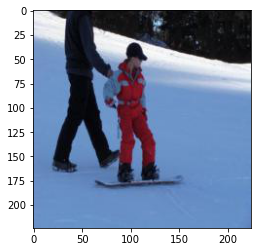

man stand next zebra lawn guy show zebra building young man pose next zebra grassy wildlife exhibit man stand next zebra grass man stand next zebra gesture gesture



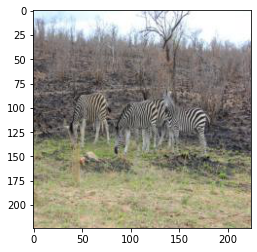

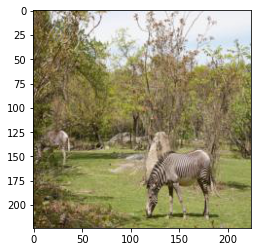

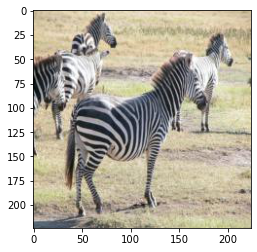

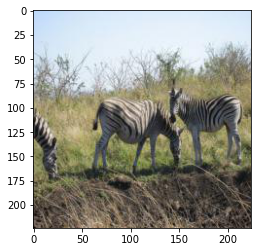

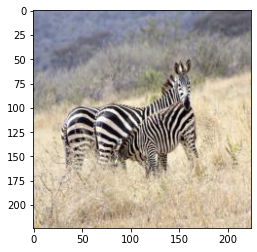

...

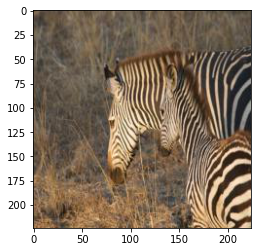

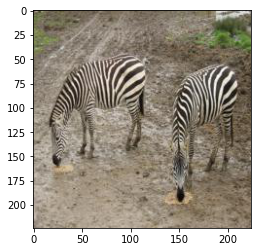

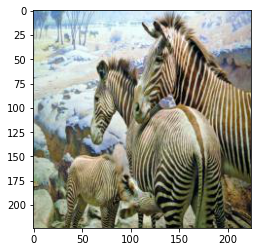

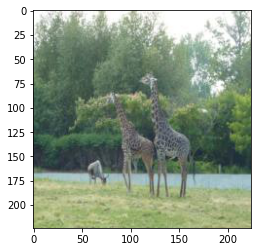

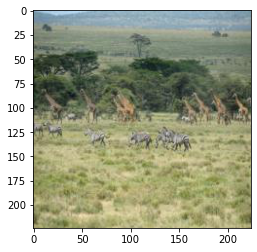

orange fire truck park park antique truck display work garage red fire engine park fire station red fire engine engine build old model fire truck sit sit room



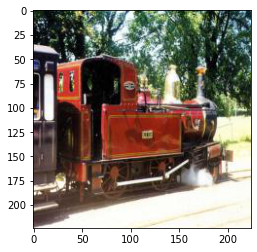

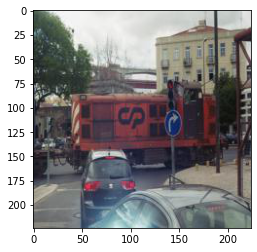

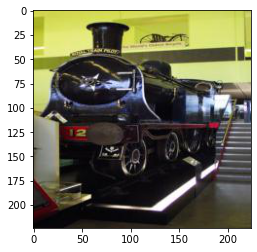

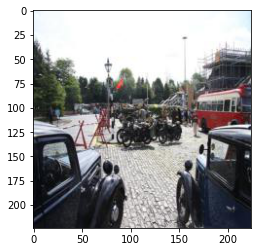

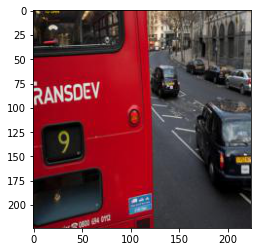

...

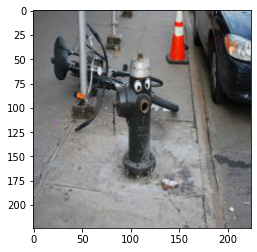

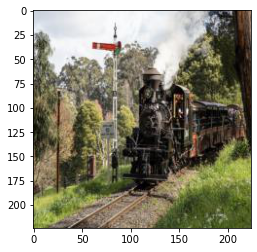

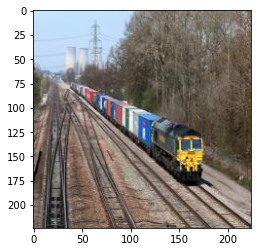

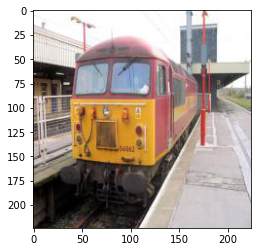

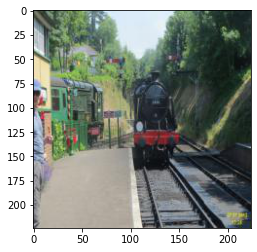

people stand skateboard group skateboarders stand top ramp skateboard rest top ramp ramp boys stand ready skateboard skateboard skateboarder stand top ramp board ready skate guy stand top ramp skateboads



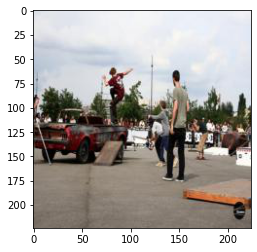

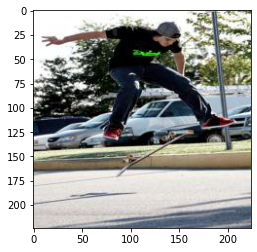

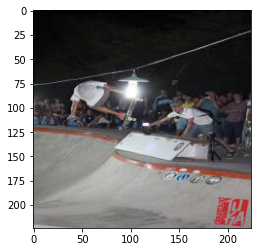

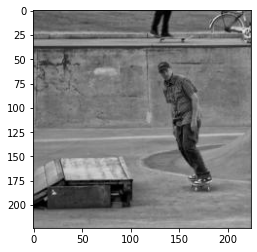

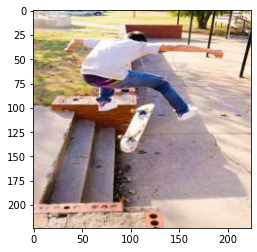

...

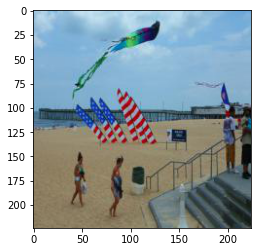

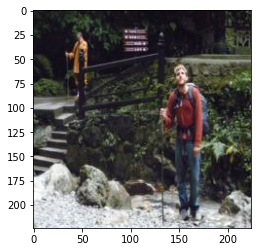

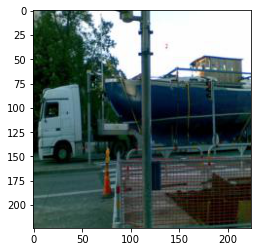

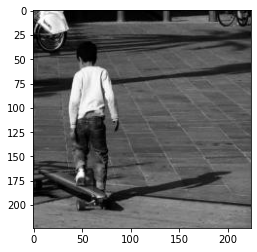

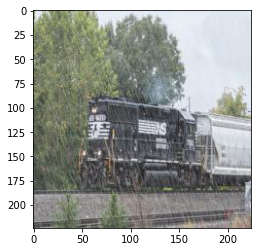

In [159]:
for row in range(10):
    desc = get_description(int(df_submit.head(10)['Description_ID'][row][:-4]),train_set=False)
    print(desc+'\n')
    row_imgs_lst = df_submit.head(10)['Top_20_Image_IDs'][row].split()
    for img_jpg in row_imgs_lst:
        img_num = int(img_jpg[:-4])
        show_image(img_num,train_set=False)

In [160]:
# Write to file
df_submit.to_csv("my_submission.csv", index=False)

# Further Directions

Here are some (unvetted) ideas to try:

* **Incorporate additional features:** Think about how you can incorporate the tag data. `word2vec` or similar models can be useful for this task.
* **Improve the baseline:**
    * Can we do better than random projection for the ResNet features? Do you know any other dimensionality reduction techniques that might help? (*cough* e.g. PCA *cough*)
    * Can we do better than a Ridge model? Maybe another type of regularized linear model? Maybe a non-linear model?
    * Is the euclidian distance the best distance metric to use? 
* **Think outside the box:** literally. Incorporate other language/vision models that exist out there. Get creative about the kind of additional data you can use, etc.

Finally, if all fails:

<img src="https://imgs.xkcd.com/comics/machine_learning_2x.png" width="500"/>
